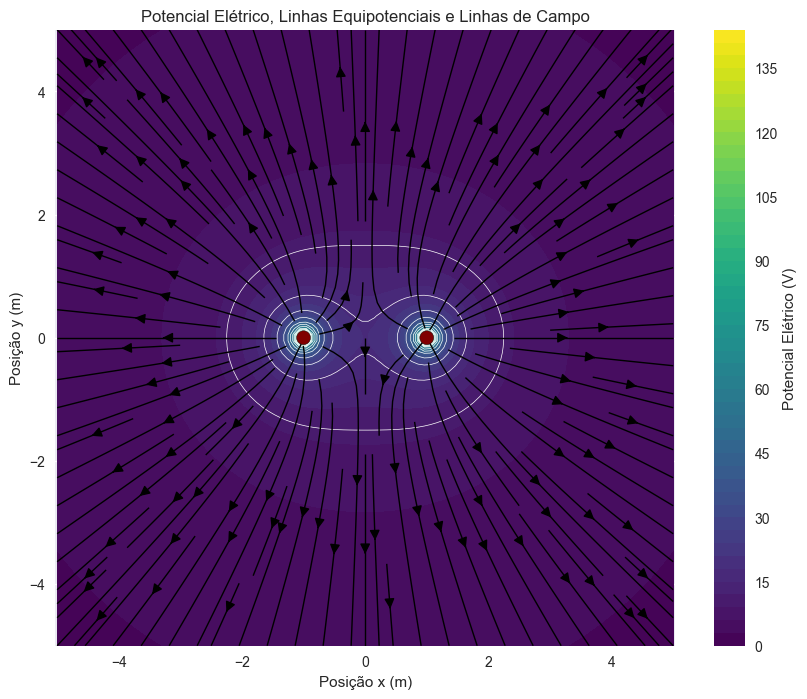

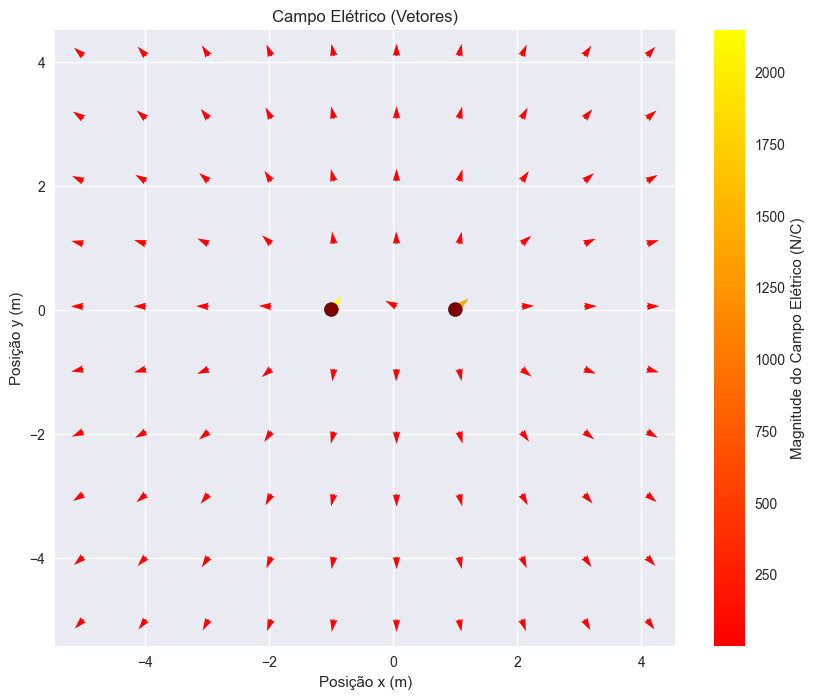

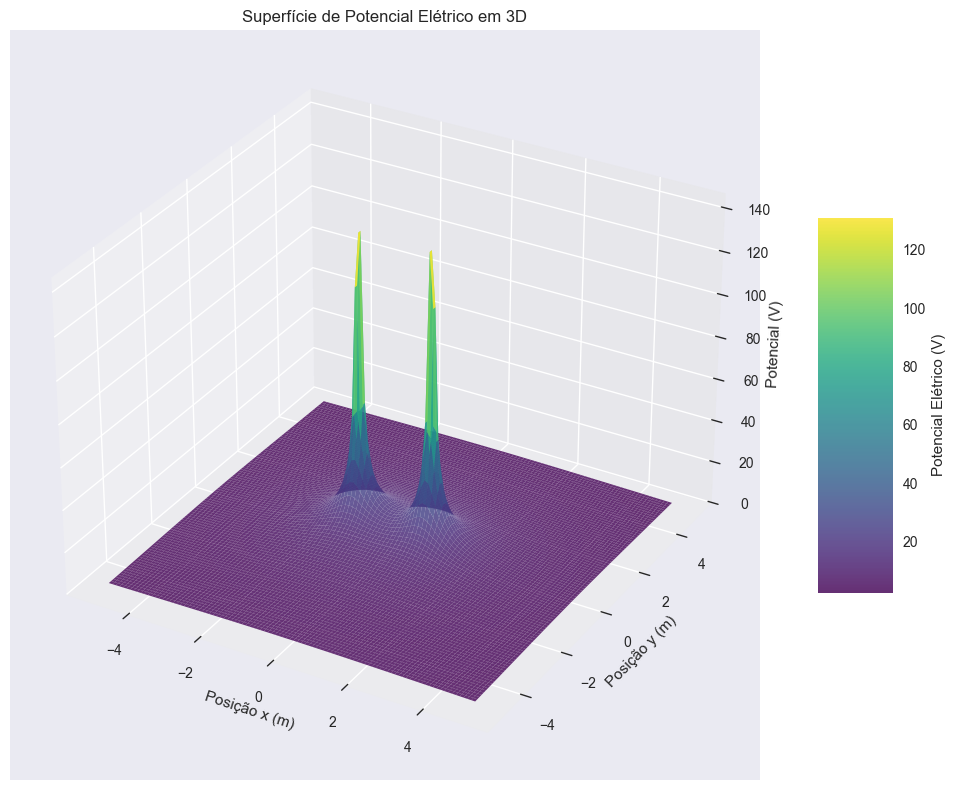


--- Análise de Diferença de Potencial e Energia ---
Observações dos gráficos:
- O potencial é mais intenso próximo às cargas e diminui com a distância.
- Para cargas positivas, o potencial é positivo; para negativas, é negativo.
- O campo elétrico aponta na direção de maior para menor potencial.

Conceitos importantes:
1. Diferença de Potencial (ΔV): V_B - V_A
2. Energia Potencial Elétrica: U = q_test * V
3. Trabalho da força elétrica: W = -ΔU = -q_test * ΔV

Sugestões para exploração:
- Modifique a posição e valor das cargas e observe os efeitos.
- Calcule a diferença de potencial entre dois pontos específicos.
- Estime o trabalho necessário para mover uma carga entre dois pontos.


In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Para o gráfico 3D do potencial

# --- Configuração da Simulação ---
x_min, x_max = -5, 5
y_min, y_max = -5, 5
grid_points = 100  # <<< Define a resolução da malha (quanto maior, mais preciso)

# Criação de uma malha (grid) bidimensional de pontos
x = np.linspace(x_min, x_max, grid_points)
y = np.linspace(y_min, y_max, grid_points)
X, Y = np.meshgrid(x, y)  # <<< Matrizes de coordenadas para cada ponto do plano

# Definir as cargas pontuais [posição x, posição y, valor da carga (Coulombs)]
# Exemplos:
# Dipolo:
# charges = np.array([[1, 0, 1e-9], [-1, 0, -1e-9]])  # +1nC em (1,0) e -1nC em (-1,0)

# Duas cargas positivas:
charges = np.array([[1, 0, 1e-9], [-1, 0, 1e-9]])  # +1nC em (1,0) e +1nC em (-1,0)

# Uma única carga positiva:
# charges = np.array([[0, 0, 1e-9]])  # +1nC em (0,0)

k = 8.9875517923e9  # Constante eletrostática (N·m²/C²)
epsilon = 1e-9  # <<< Termo para evitar divisão por zero (regularização numérica)

# Inicializar campos (potencial elétrico e componentes do campo elétrico)
potential = np.zeros_like(X)
Ex = np.zeros_like(X)
Ey = np.zeros_like(X)

# --- Cálculo do Potencial Elétrico e do Campo Elétrico para cada carga ---
for charge in charges:
    qx, qy, q_value = charge
    r = np.sqrt((X - qx)**2 + (Y - qy)**2 + epsilon**2)  # <<< Distância de cada ponto até a carga
    potential += k * q_value / r  # <<< Superposição de potenciais escalares
    Ex += k * q_value * (X - qx) / (r**3)  # <<< Componente x do campo elétrico (derivada de V)
    Ey += k * q_value * (Y - qy) / (r**3)  # <<< Componente y do campo elétrico

# --- Visualização: Potencial + Linhas Equipotenciais + Campo Elétrico (Streamplot) ---
plt.style.use('seaborn-v0_8')
plt.figure(figsize=(10, 8))

# Mapa de cores do potencial elétrico
contour = plt.contourf(X, Y, potential, levels=50, cmap='viridis')
plt.colorbar(contour, label='Potencial Elétrico (V)')  # <<< Barra de cores

# Linhas equipotenciais (curvas onde o potencial é constante)
levels = np.linspace(potential.min(), potential.max(), 20)
plt.contour(X, Y, potential, levels=levels, colors='white', linewidths=0.5)

# Linhas de campo elétrico (fluxo vetorial do campo E)
plt.streamplot(X, Y, Ex, Ey, color='black', linewidth=1, density=1.5, arrowsize=1.5)

# Marcar as posições das cargas no gráfico
plt.scatter(charges[:, 0], charges[:, 1], c=charges[:, 2],
            cmap='seismic', s=100, edgecolors='black', zorder=3)
plt.clim(-abs(charges[:, 2]).max(), abs(charges[:, 2]).max())  # <<< Ajuste de cores

# Configurações finais do gráfico
plt.title('Potencial Elétrico, Linhas Equipotenciais e Linhas de Campo')
plt.xlabel('Posição x (m)')
plt.ylabel('Posição y (m)')
plt.axis('equal')
plt.grid(True)

# --- Visualização: Vetores do Campo Elétrico ---
plt.figure(figsize=(10, 8))
skip = slice(None, None, 10)  # <<< Subamostragem para não sobrecarregar o gráfico

E_mag = np.sqrt(Ex**2 + Ey**2)  # <<< Módulo do vetor campo elétrico
Ex_norm = Ex / (E_mag + 1e-12)  # <<< Normalização dos vetores para indicar direção
Ey_norm = Ey / (E_mag + 1e-12)

# Mapa de vetores (quiver) do campo elétrico com coloração baseada na magnitude
plt.quiver(X[skip, skip], Y[skip, skip],
           Ex_norm[skip, skip], Ey_norm[skip, skip],
           E_mag[skip, skip], cmap='autumn', scale=50)

plt.colorbar(label='Magnitude do Campo Elétrico (N/C)')
plt.scatter(charges[:, 0], charges[:, 1], c=charges[:, 2],
            cmap='seismic', s=100, edgecolors='black', zorder=3)
plt.clim(-abs(charges[:, 2]).max(), abs(charges[:, 2]).max())

plt.title('Campo Elétrico (Vetores)')
plt.xlabel('Posição x (m)')
plt.ylabel('Posição y (m)')
plt.axis('equal')
plt.grid(True)

# --- Visualização 3D do Potencial ---
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

pot_plot = np.clip(potential, -1e4, 1e4)  # <<< Prevenção contra valores extremos no gráfico

# Superfície 3D do potencial
surf = ax.plot_surface(X, Y, pot_plot, cmap='viridis',
                      antialiased=True, rstride=1, cstride=1,
                      linewidth=0, alpha=0.8)

fig.colorbar(surf, shrink=0.5, aspect=5, label='Potencial Elétrico (V)')
ax.set_xlabel('Posição x (m)')
ax.set_ylabel('Posição y (m)')
ax.set_zlabel('Potencial (V)')
ax.set_title('Superfície de Potencial Elétrico em 3D')

plt.tight_layout()
plt.show()

# --- Análise ---
# <<< Explicações e sugestões para interpretação dos gráficos
print("\n--- Análise de Diferença de Potencial e Energia ---")
print("Observações dos gráficos:")
print("- O potencial é mais intenso próximo às cargas e diminui com a distância.")
print("- Para cargas positivas, o potencial é positivo; para negativas, é negativo.")
print("- O campo elétrico aponta na direção de maior para menor potencial.")
print("\nConceitos importantes:")
print("1. Diferença de Potencial (ΔV): V_B - V_A")
print("2. Energia Potencial Elétrica: U = q_test * V")
print("3. Trabalho da força elétrica: W = -ΔU = -q_test * ΔV")
print("\nSugestões para exploração:")
print("- Modifique a posição e valor das cargas e observe os efeitos.")
print("- Calcule a diferença de potencial entre dois pontos específicos.")
print("- Estime o trabalho necessário para mover uma carga entre dois pontos.")


<Figure size 800x550 with 0 Axes>

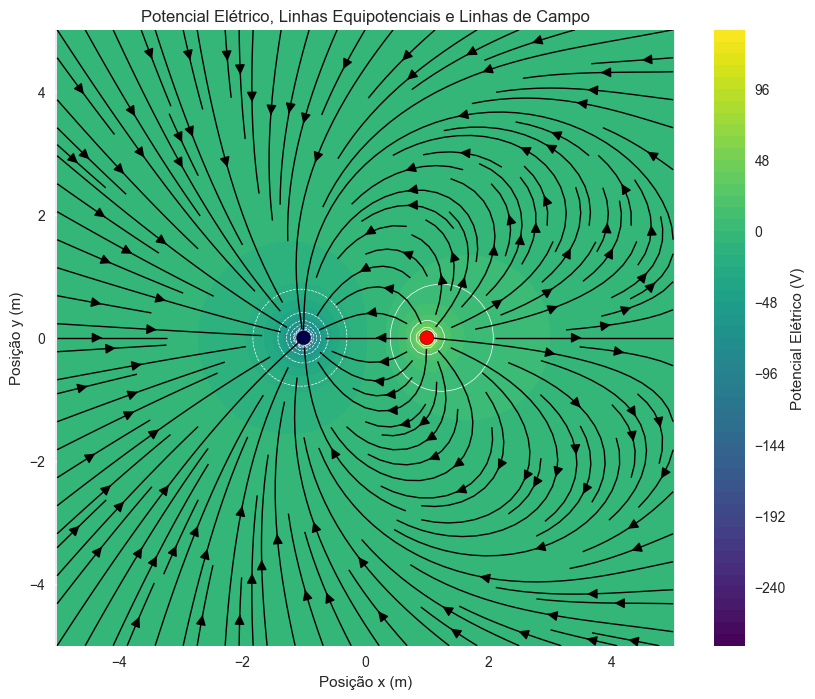

<Figure size 800x550 with 0 Axes>

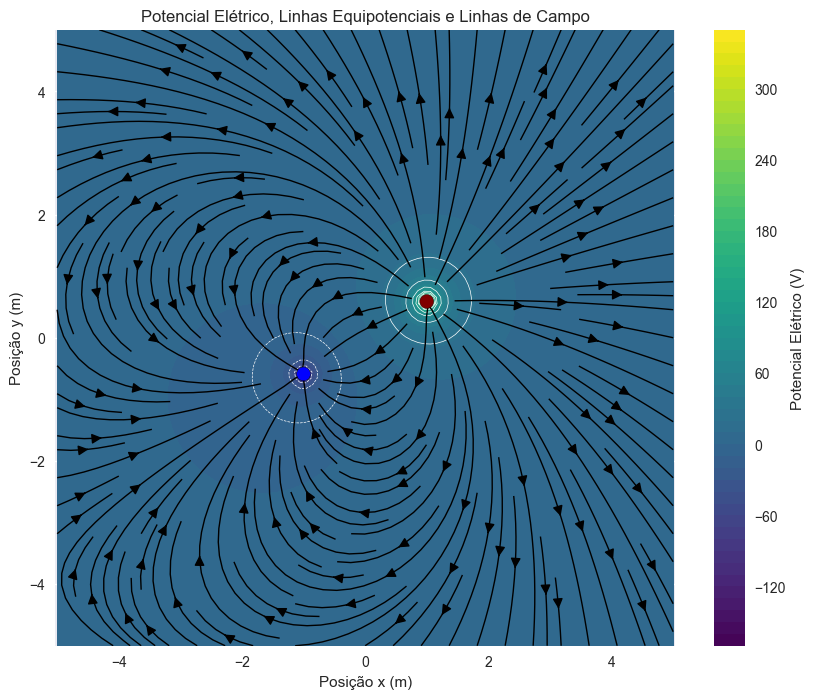

<Figure size 800x550 with 0 Axes>

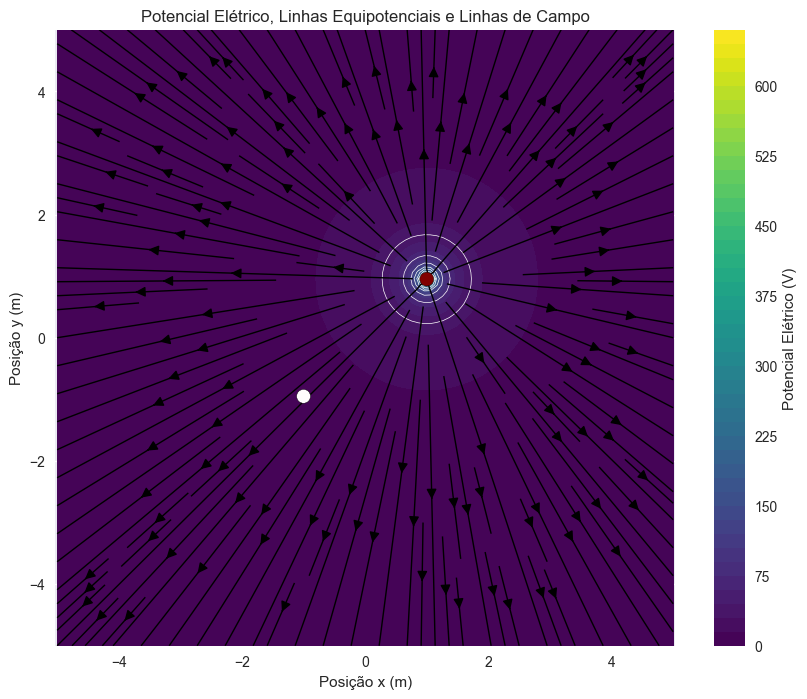

<Figure size 800x550 with 0 Axes>

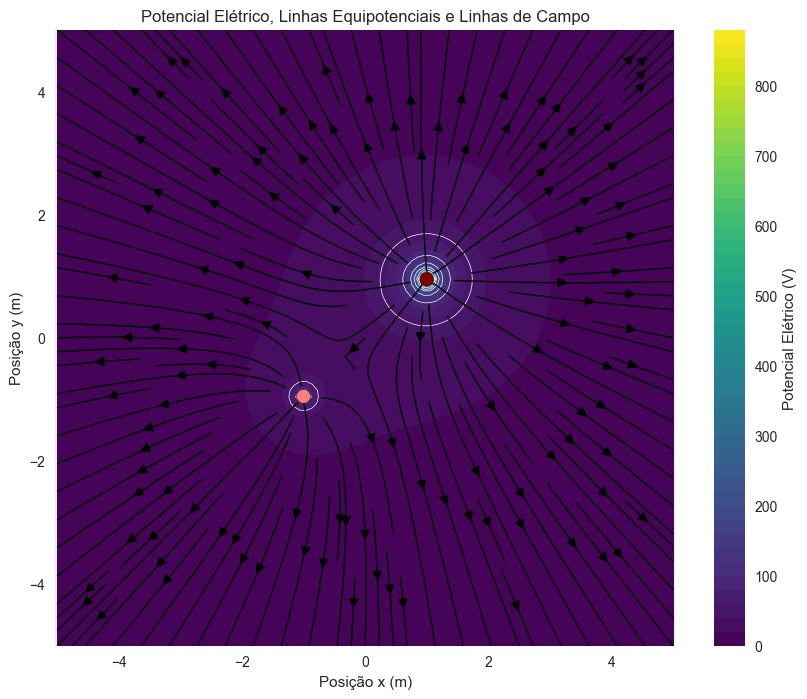

<Figure size 800x550 with 0 Axes>

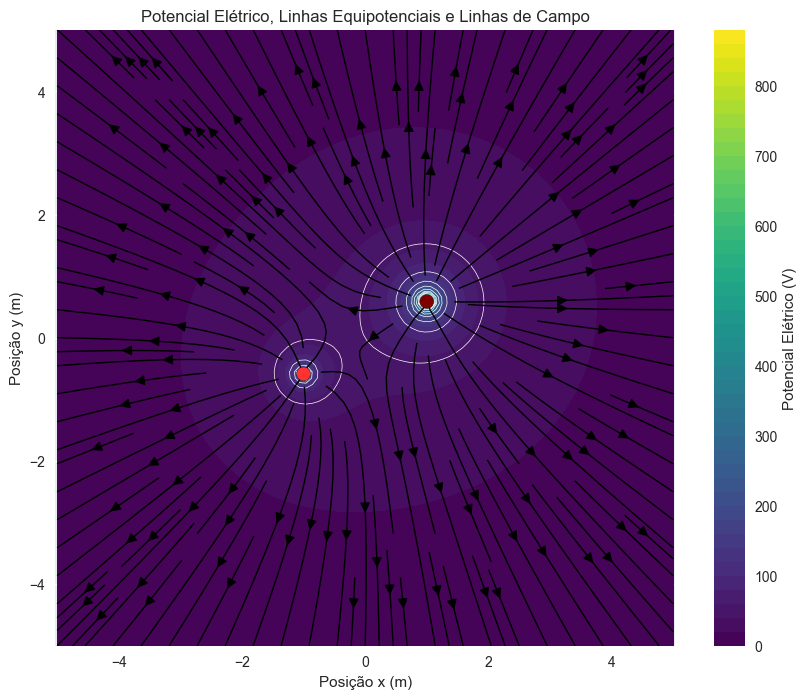

In [2]:
import numpy as np
import matplotlib.pyplot as plt

# --- Configuração da Simulação ---
x_min, x_max = -5, 5
y_min, y_max = -5, 5
grid_points = 100
x = np.linspace(x_min, x_max, grid_points)
y = np.linspace(y_min, y_max, grid_points)
X, Y = np.meshgrid(x, y)
k = 8.9875517923e9
epsilon = 1e-9

# --- Animação: Variação da Carga e da Posição ---
num_frames = 5  # Número de quadros na animação

plt.ion()  # Modo interativo para animação

for i in range(num_frames):
    # Varia a posição y e valor das cargas ao longo do tempo
    pos_y = np.sin(i * np.pi / num_frames)
    carga_valor_1 = (i + 1) * 1e-9  # Aumenta o valor da carga a cada frame
    carga_valor_2 = (-i + 2) * 1e-9  # Aumenta o valor da carga a cada frame

    # Definir as cargas pontuais [posição x, posição y, valor da carga (Coulombs)]
    # Exemplos:
    # Dipolo:
    # charges = np.array([[1, pos_x, carga_valor], [-1, pos_y, -carga_valor]])  # +1nC em (1,0) e -1nC em (-1,0)

    # Duas cargas positivas:
    charges = np.array([[1, pos_y, carga_valor_1], [-1, -pos_y, -carga_valor_2]])

    # Uma única carga positiva:
    #charges = np.array([[0, 0, carga_valor]])  # +1nC em (0,0)]

    # Recalcula potencial e campo
    potential = np.zeros_like(X)
    Ex = np.zeros_like(X)
    Ey = np.zeros_like(X)

    for charge in charges:
        qx, qy, q_value = charge
        r = np.sqrt((X - qx)**2 + (Y - qy)**2 + epsilon**2)
        potential += k * q_value / r
        Ex += k * q_value * (X - qx) / (r**3)
        Ey += k * q_value * (Y - qy) / (r**3)

    # --- Gráfico do Campo Elétrico ---
    plt.clf()
    plt.figure(1, figsize=(10, 8))
    skip = slice(None, None, 10)
    E_mag = np.sqrt(Ex**2 + Ey**2)
    Ex_norm = Ex / (E_mag + 1e-12)
    Ey_norm = Ey / (E_mag + 1e-12)

   # --- Visualização: Potencial + Linhas Equipotenciais + Campo Elétrico (Streamplot) ---
    plt.style.use('seaborn-v0_8')
    plt.figure(figsize=(10, 8))

    # Mapa do potencial
    contour = plt.contourf(X, Y, potential, levels=50, cmap='viridis')
    plt.colorbar(contour, label='Potencial Elétrico (V)')

    # Linhas equipotenciais
    levels = np.linspace(potential.min(), potential.max(), 20)
    plt.contour(X, Y, potential, levels=levels, colors='white', linewidths=0.5)

    # Linhas de campo elétrico (streamplot)
    plt.streamplot(X, Y, Ex, Ey, color='black', linewidth=1, density=1.5, arrowsize=1.5)

    # Marcar as cargas
    plt.scatter(charges[:, 0], charges[:, 1], c=charges[:, 2],
                cmap='seismic', s=100, edgecolors='black', zorder=3)
    plt.clim(-abs(charges[:, 2]).max(), abs(charges[:, 2]).max())

    plt.title('Potencial Elétrico, Linhas Equipotenciais e Linhas de Campo')
    plt.xlabel('Posição x (m)')
    plt.ylabel('Posição y (m)')
    plt.axis('equal')
    plt.grid(True)

    plt.pause(2)

plt.ioff()
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# --- Configuração da Simulação ---
x_min, x_max = -5, 5
y_min, y_max = -5, 5
grid_points = 100
x = np.linspace(x_min, x_max, grid_points)
y = np.linspace(y_min, y_max, grid_points)
X, Y = np.meshgrid(x, y)
k = 8.9875517923e9
epsilon = 1e-9
num_frames = 30  # Número de quadros na animação

# --- Criação da Figura ---
fig, ax = plt.subplots(figsize=(10, 8))
plt.style.use('seaborn-v0_8')

def update(i):
    ax.clear()

    # --- Atualização das cargas ---
    pos_y = np.sin(i * np.pi / num_frames)
    carga_valor_1 = (i + 1) * 1e-9
    carga_valor_2 = (-i + 2) * 1e-9
    charges = np.array([[1, pos_y, carga_valor_1], [-1, -pos_y, -carga_valor_2]])

    # --- Cálculo do campo elétrico e potencial ---
    potential = np.zeros_like(X)
    Ex = np.zeros_like(X)
    Ey = np.zeros_like(X)

    for charge in charges:
        qx, qy, q_value = charge
        r = np.sqrt((X - qx)**2 + (Y - qy)**2 + epsilon**2)
        potential += k * q_value / r
        Ex += k * q_value * (X - qx) / r**3
        Ey += k * q_value * (Y - qy) / r**3

    # --- Visualização ---
    contour = ax.contourf(X, Y, potential, levels=50, cmap='viridis')
    ax.contour(X, Y, potential, levels=20, colors='white', linewidths=0.5)
    ax.streamplot(X, Y, Ex, Ey, color='black', linewidth=1, density=1.5, arrowsize=1.5)

    # Marcar as cargas
    sc = ax.scatter(charges[:, 0], charges[:, 1], c=charges[:, 2],
                    cmap='seismic', s=100, edgecolors='black', zorder=3)
    ax.set_title(f'Quadro {i + 1} - Campo e Potencial Elétrico')
    ax.set_xlabel('x (m)')
    ax.set_ylabel('y (m)')
    ax.axis('equal')
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    ax.grid(True)

    return contour.collections + [sc]

# --- Criação da animação ---
ani = animation.FuncAnimation(fig, update, frames=num_frames, interval=200, blit=False)

# Para exibir no notebook (Jupyter/Colab)
plt.close(fig)
HTML(ani.to_jshtml())



C:\Users\pamel\AppData\Local\Temp\ipykernel_19068\3443991666.py:58: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed in 3.10.
  return contour.collections + [sc]


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# --- Configuração da grade de simulação ---
x_min, x_max = -5, 5
y_min, y_max = -5, 5
grid_points = 100

x = np.linspace(x_min, x_max, grid_points)
y = np.linspace(y_min, y_max, grid_points)
X, Y = np.meshgrid(x, y)

# Constantes físicas
k = 8.9875517923e9  # Constante eletrostática
epsilon = 1e-9      # Pequeno valor para evitar divisão por zero

# Número de quadros na animação
num_frames = 30

# Ativa modo interativo
plt.ion()
fig, ax = plt.subplots(figsize=(10, 8))

# Criação da barra de cores (vinculada ao primeiro frame)
colorbar = None

# Loop da animação
for i in range(num_frames):
    ax.clear()

    # Atualiza posição e valor das cargas
    pos_y = np.sin(i * 2 * np.pi / num_frames)
    carga_valor = (i + 1) * 1e-9
    charges = np.array([[1, pos_y, carga_valor], [-1, -pos_y, -carga_valor]])

    # Inicializa potencial e campo
    potential = np.zeros_like(X)
    Ex = np.zeros_like(X)
    Ey = np.zeros_like(X)

    # Calcula campo e potencial
    for charge in charges:
        qx, qy, q_value = charge
        r = np.sqrt((X - qx)**2 + (Y - qy)**2 + epsilon**2)
        potential += k * q_value / r
        Ex += k * q_value * (X - qx) / r**3
        Ey += k * q_value * (Y - qy) / r**3

    # --- Visualizações ---
    contour = ax.contourf(X, Y, potential, levels=50, cmap='viridis')

    if colorbar is None:
        colorbar = fig.colorbar(contour, ax=ax, label='Potencial Elétrico (V)')

    # Linhas equipotenciais
    levels = np.linspace(potential.min(), potential.max(), 20)
    ax.contour(X, Y, potential, levels=levels, colors='white', linewidths=0.5)

    # Campo elétrico (linhas de fluxo)
    ax.streamplot(X, Y, Ex, Ey, color='black', linewidth=1, density=1.5, arrowsize=1.5)

    # Marcar as cargas
    ax.scatter(charges[:, 0], charges[:, 1], c=charges[:, 2],
               cmap='seismic', s=100, edgecolors='black', zorder=3)

    # Configurações do gráfico
    ax.set_title(f'Frame {i+1}/{num_frames} — Potencial e Campo Elétrico')
    ax.set_xlabel('Posição x (m)')
    ax.set_ylabel('Posição y (m)')
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    ax.axis('equal')
    ax.grid(True)

    plt.pause(0.1)

# Finaliza o modo interativo
plt.ioff()
plt.show()


Animation size has reached 21136056 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
